In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib.ticker import MultipleLocator, AutoMinorLocator
import matplotlib.animation as animation

from scipy.optimize import curve_fit
import scipy.ndimage as ndimage
from scipy.stats import multivariate_normal
from scipy.ndimage import gaussian_filter
from scipy import signal
from scipy.stats import norm 
import scipy.stats as stats
import scipy.optimize as opt

from PIL import Image
import torch
import torch.nn as nn
import torch.nn.functional as F

from mpl_toolkits.mplot3d import Axes3D

from sklearn import mixture
from sklearn.mixture import GaussianMixture

import os, sys, fnmatch
from os.path import isfile, join

## Elliptical Gaussian Fitting

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_01.png


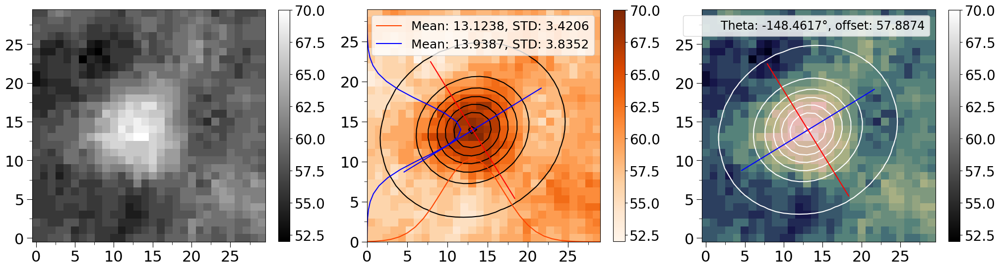

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_02.png


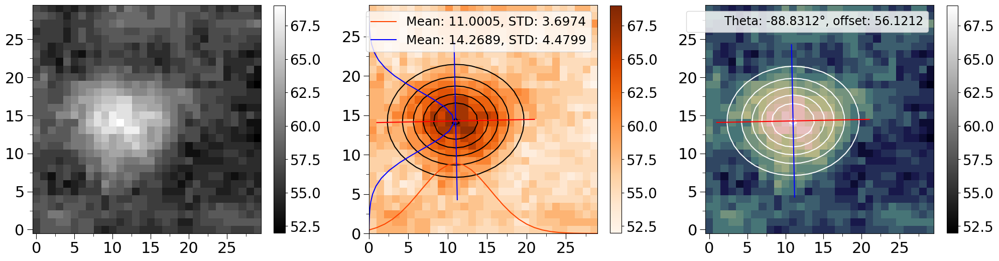

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_03.png


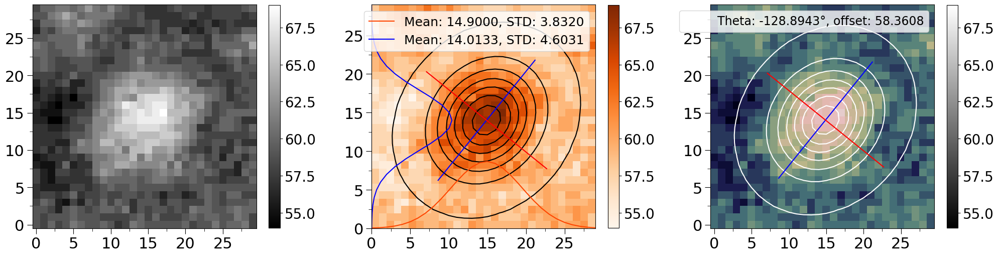

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_04.png


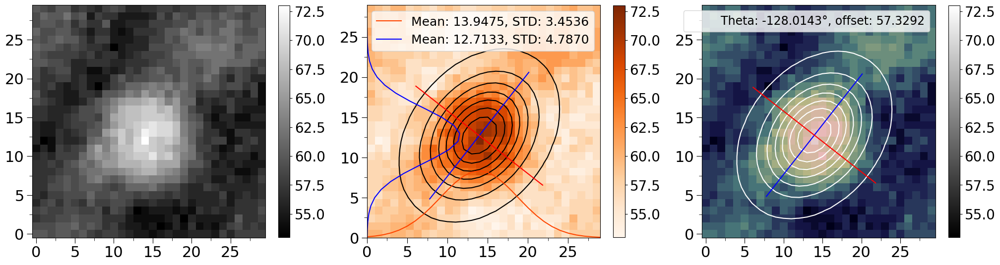

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_05.png


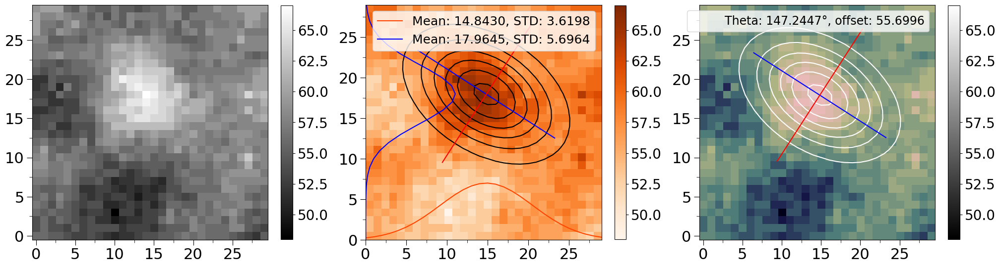

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_06.png


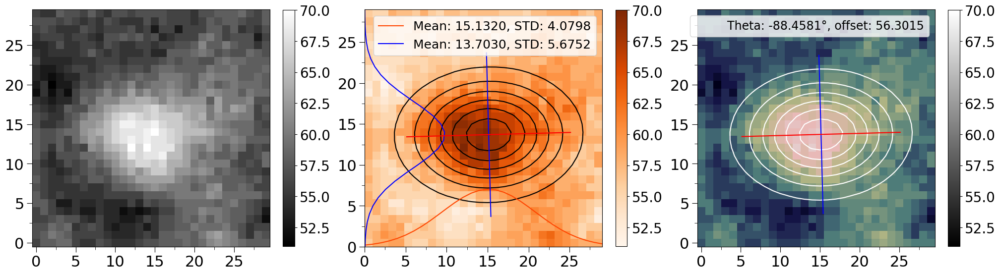

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_07.png


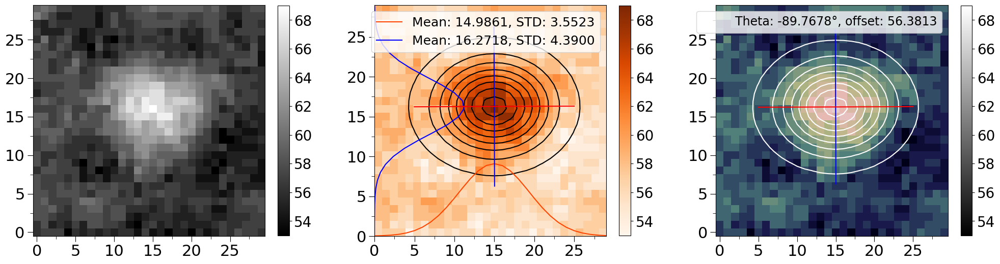

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_08.png


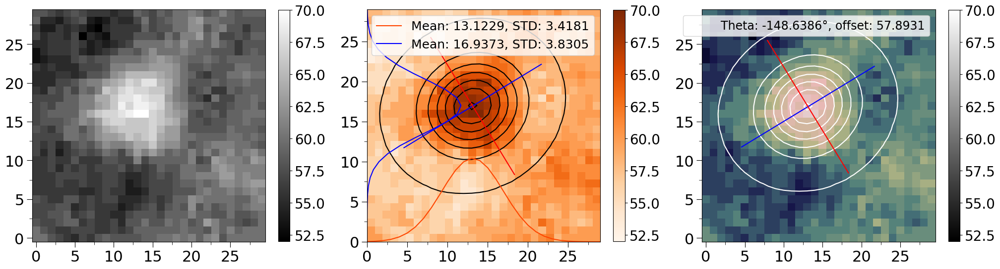

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_09.png


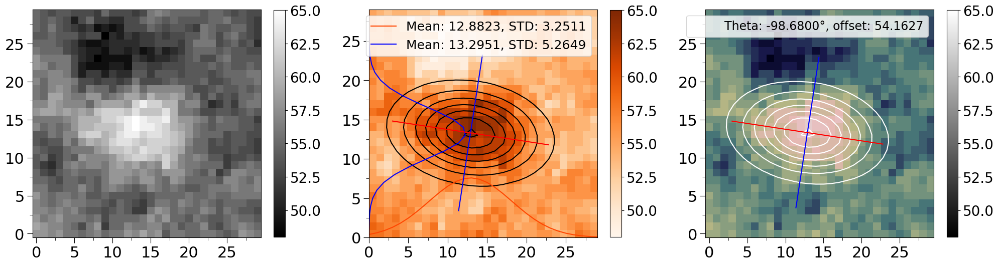

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_10.png


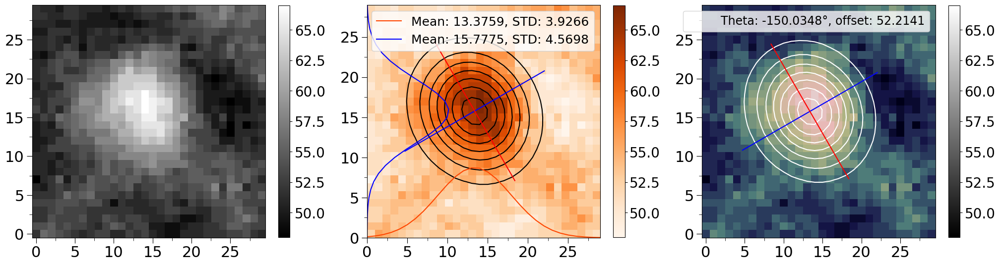

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_100.png


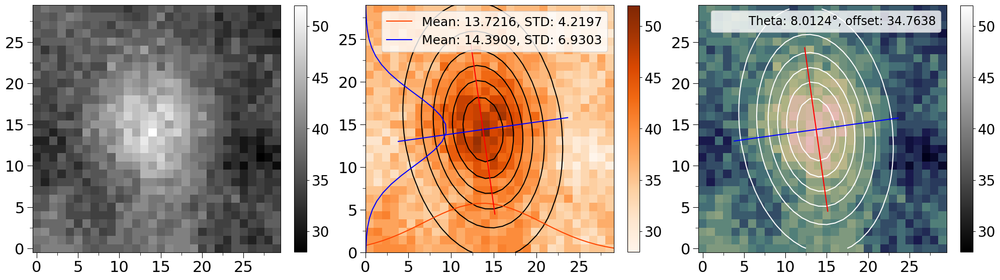

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_11.png


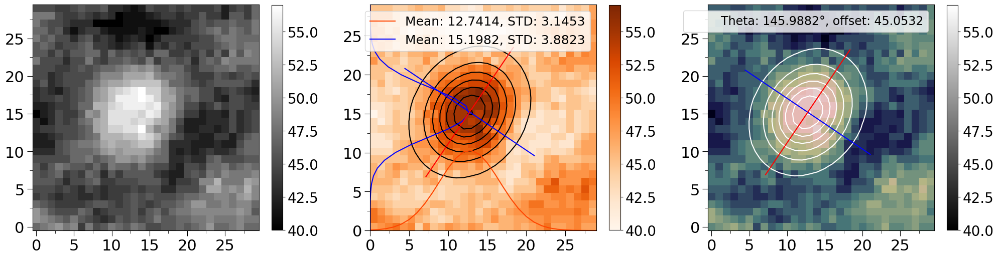

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_12.png


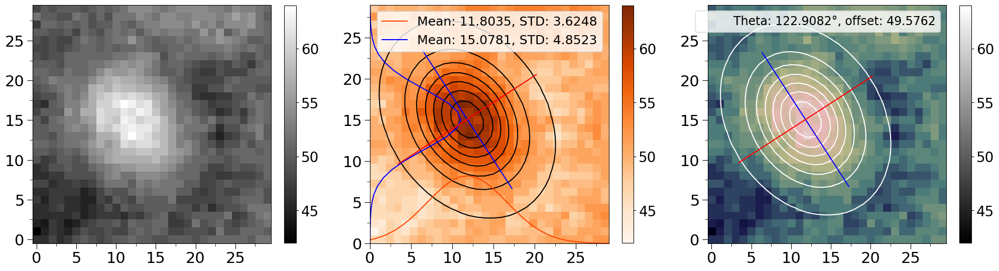

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_14.png


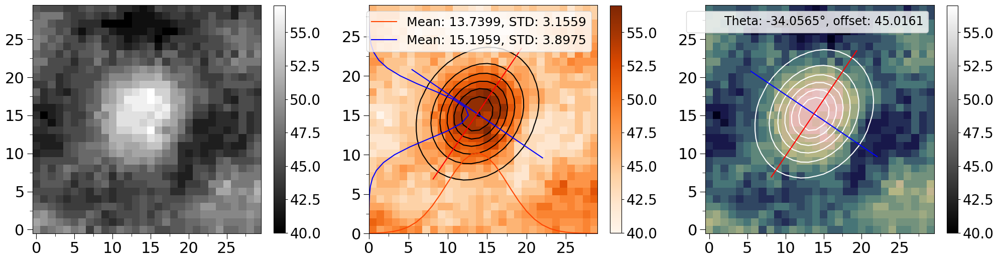

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_15.png


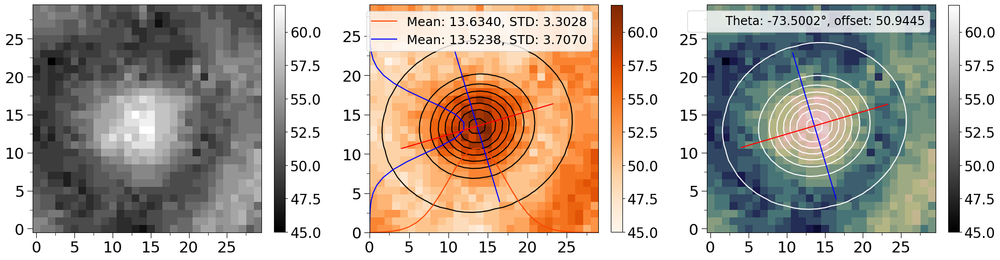

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_16.png


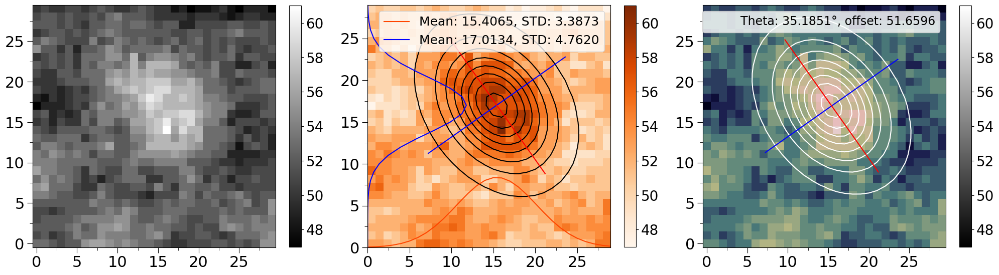

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_17.png


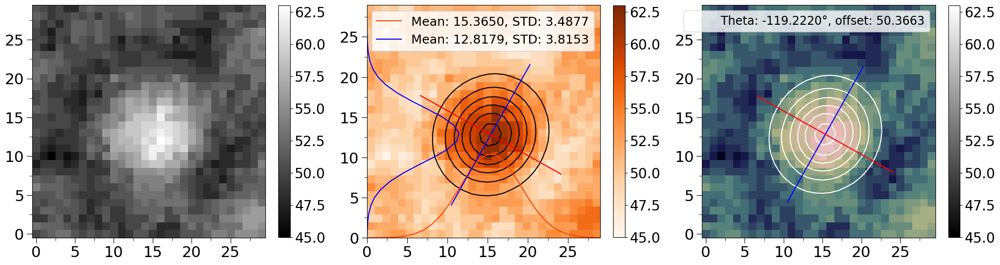

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_19.png


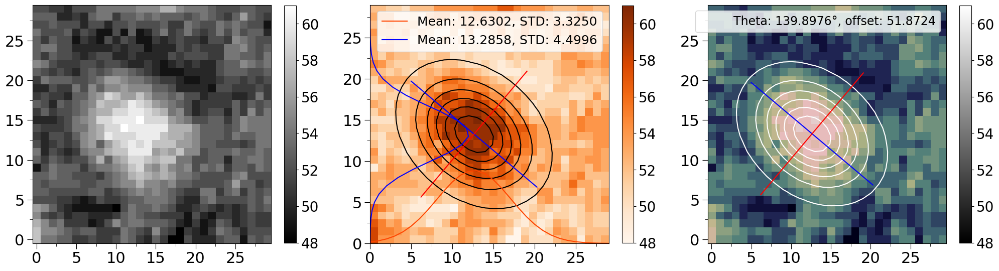

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_20.png


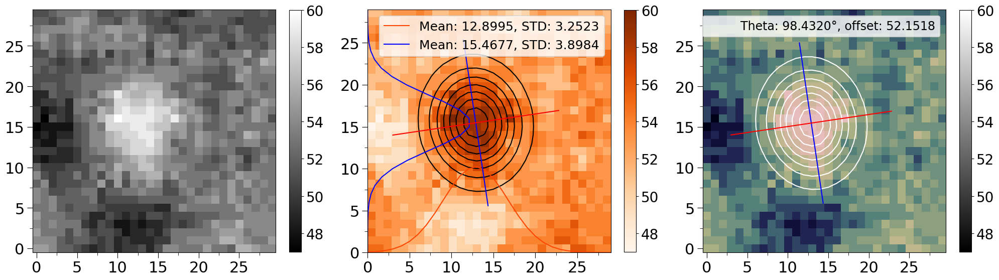

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_21.png


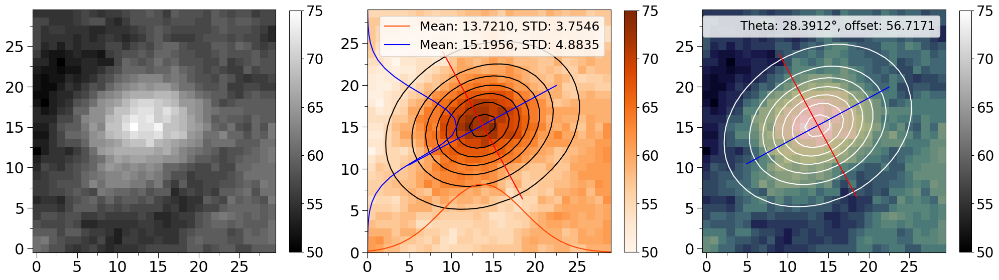

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_22.png


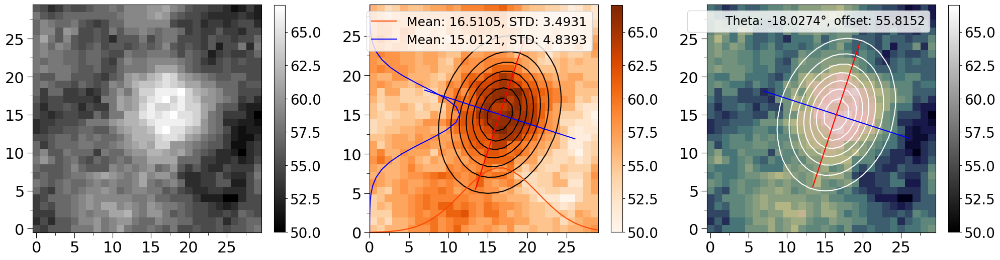

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_23.png


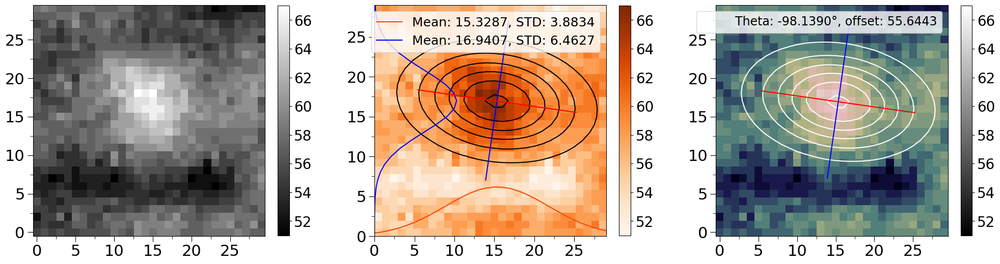

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_24.png


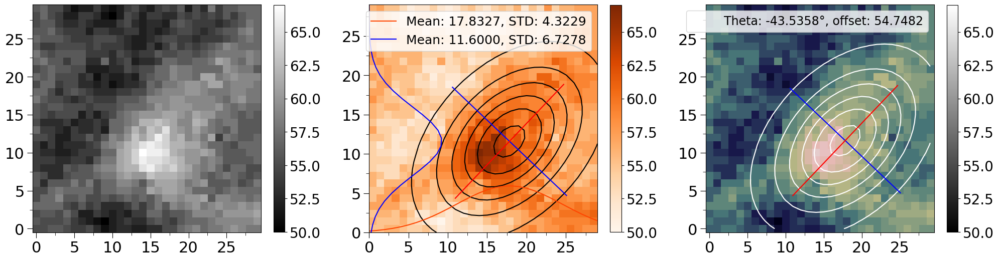

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_25.png


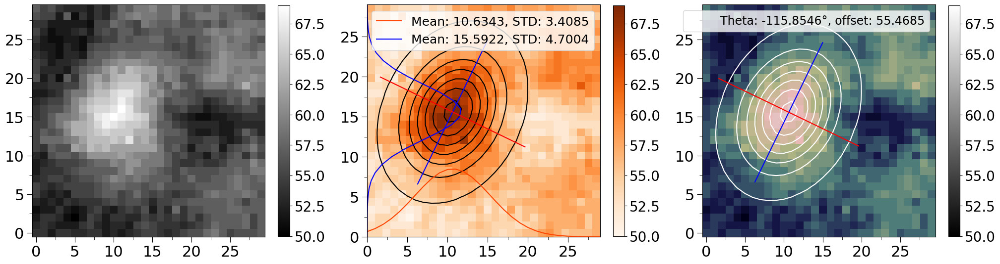

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_26.png


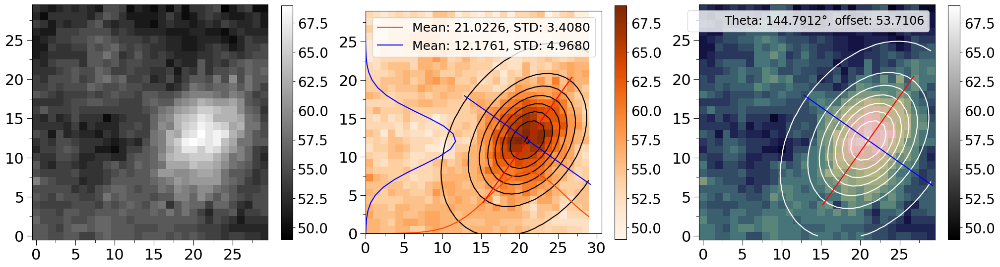

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_27.png


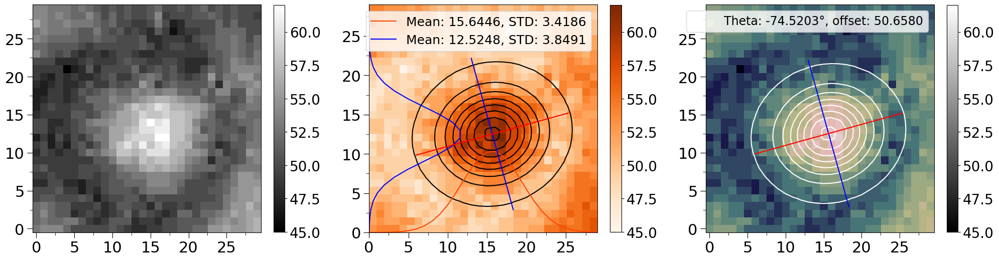

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_28.png


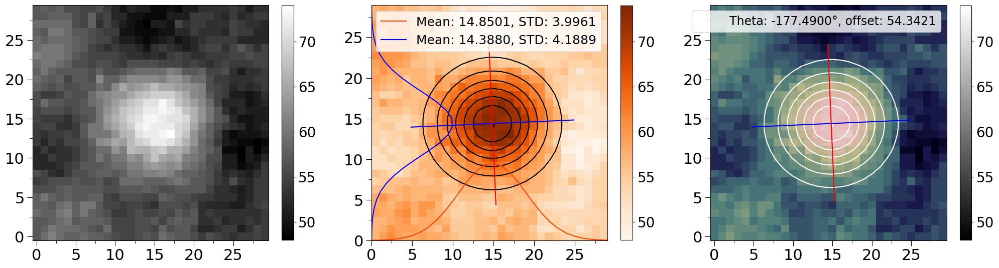

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_29.png


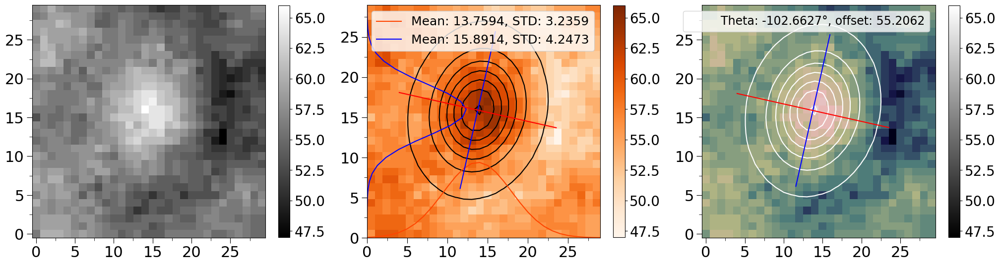

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_30.png


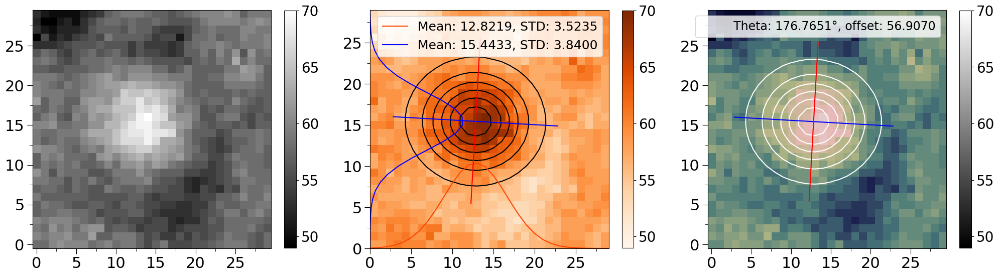

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_31.png


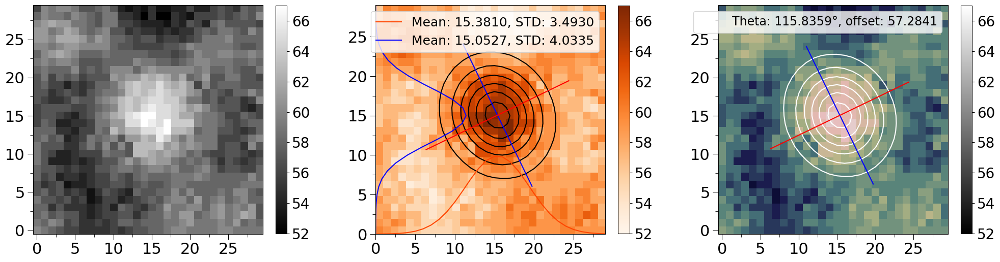

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_32.png


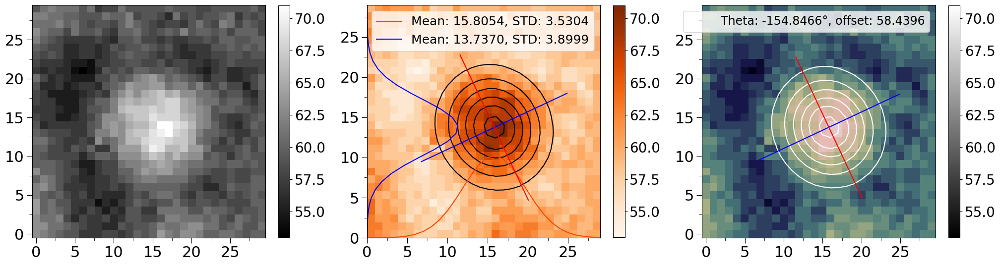

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_33.png


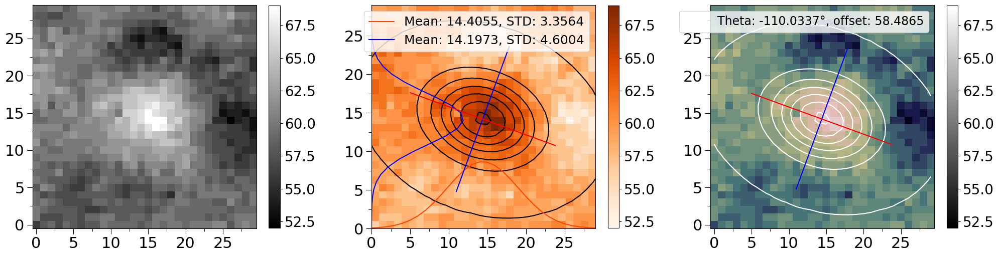

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_34.png


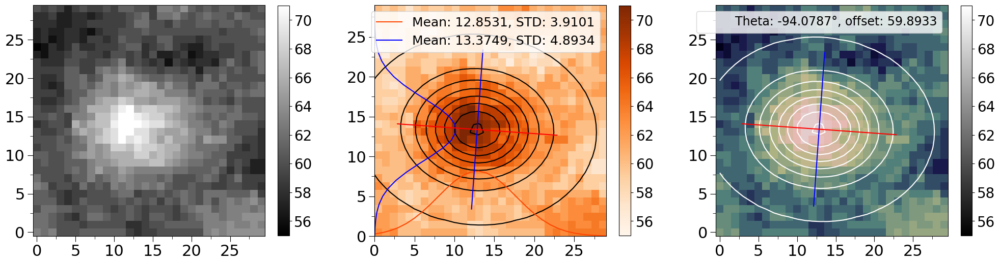

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_35.png


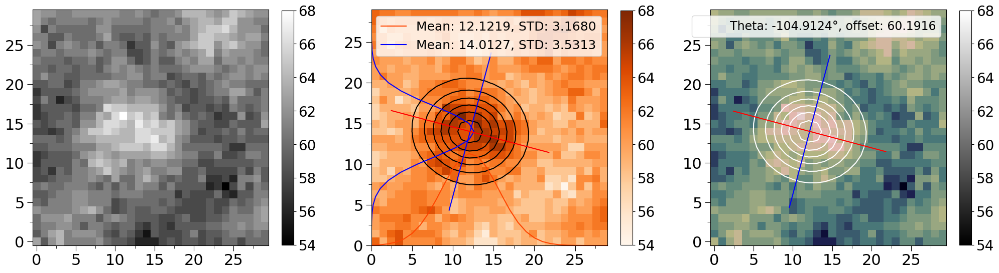

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_36.png


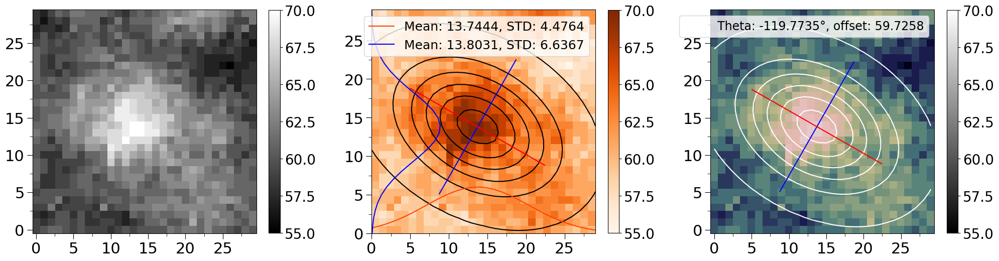

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_37.png


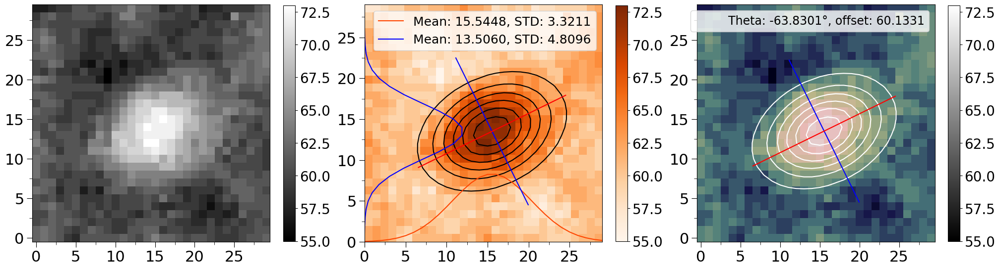

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_38.png


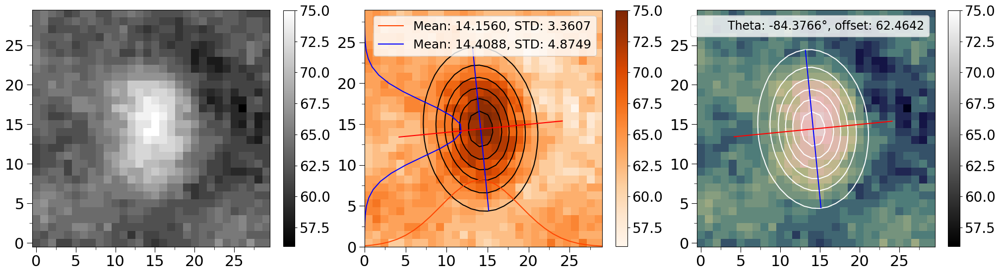

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_39.png


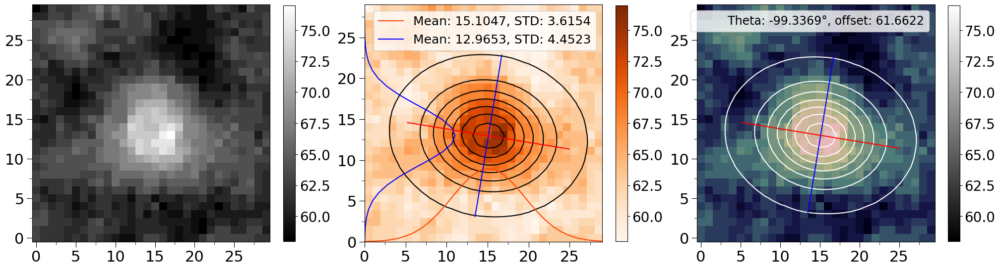

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_40.png


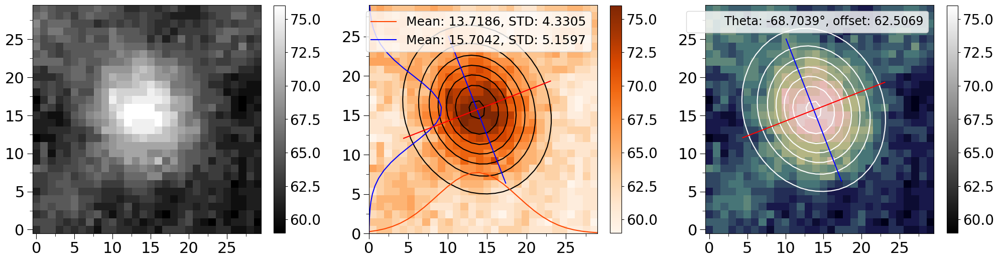

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_41.png


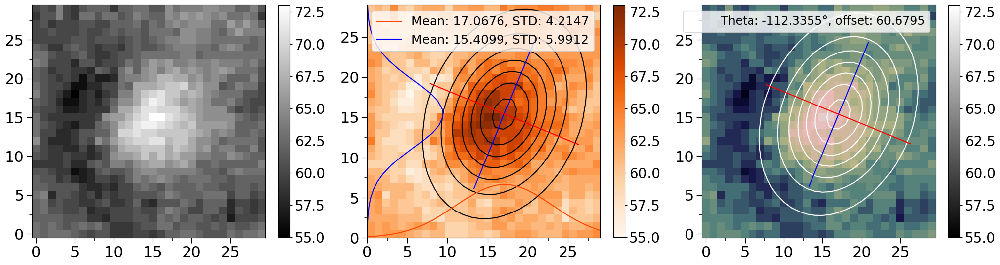

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_42.png


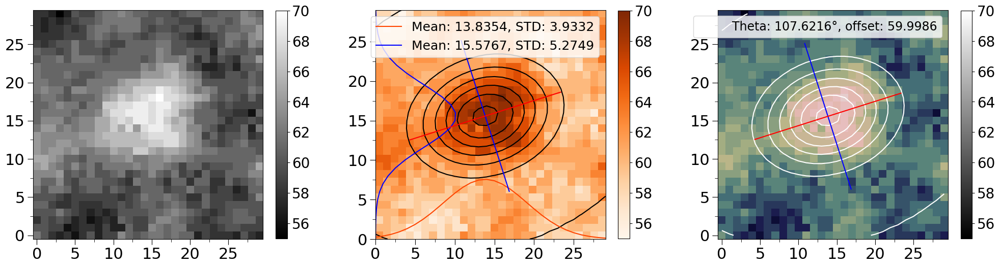

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_43.png


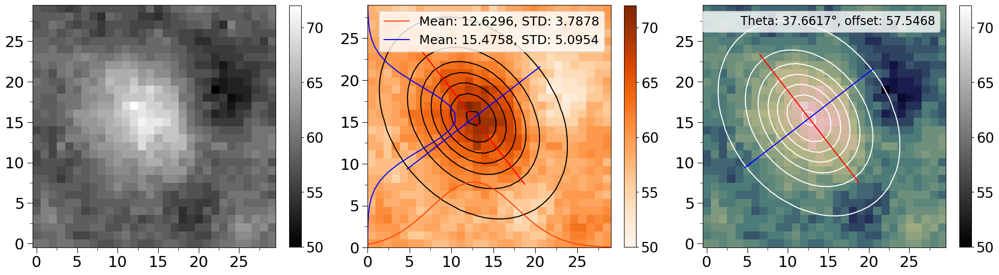

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_44.png


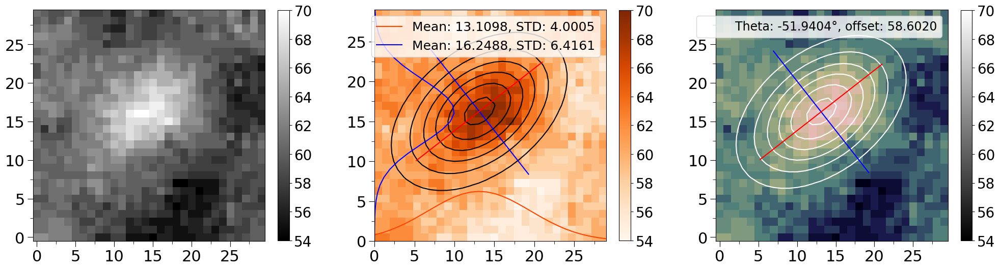

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_45.png


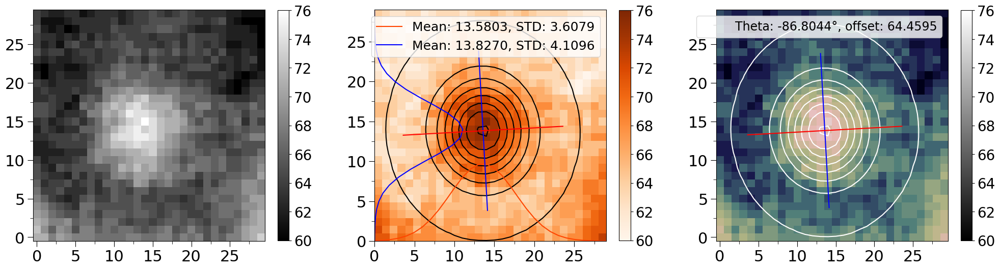

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_46.png


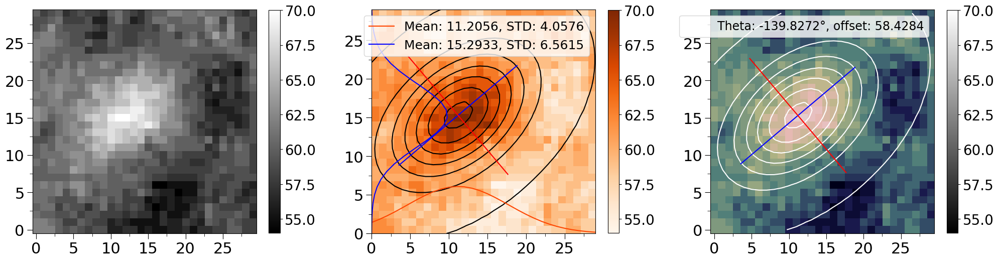

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_48.png


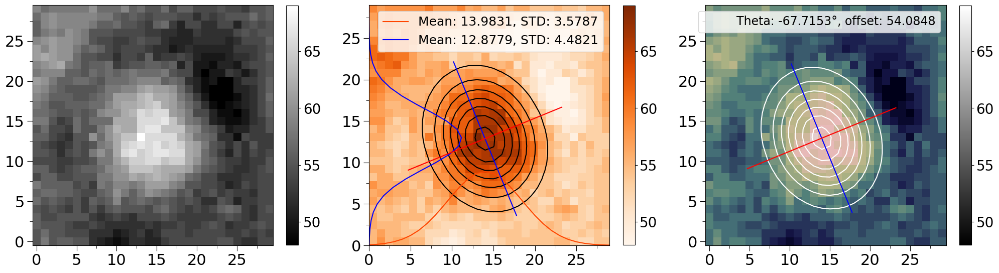

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_49.png


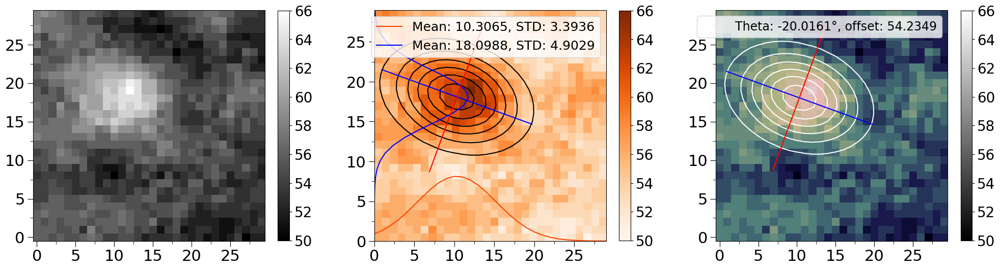

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_50.png


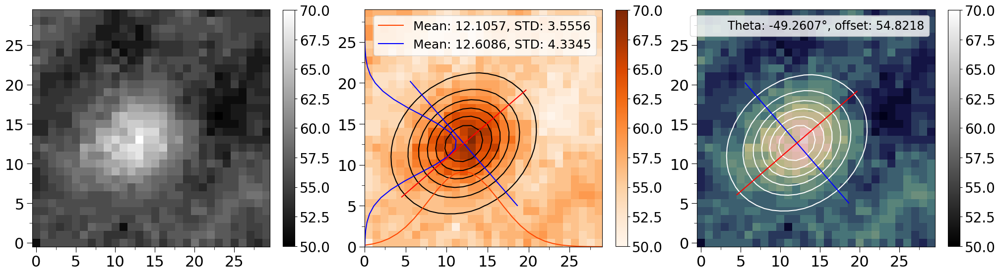

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_51.png


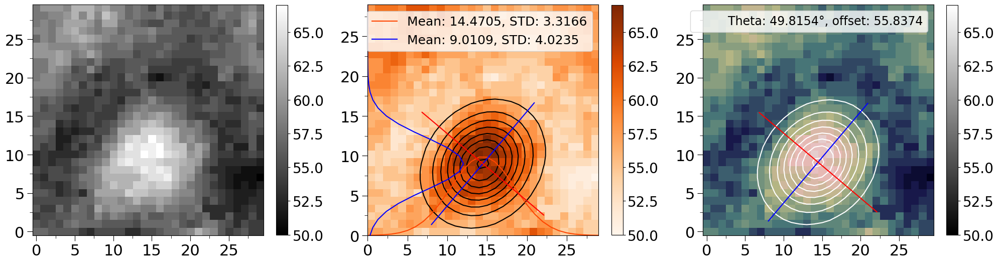

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_52.png


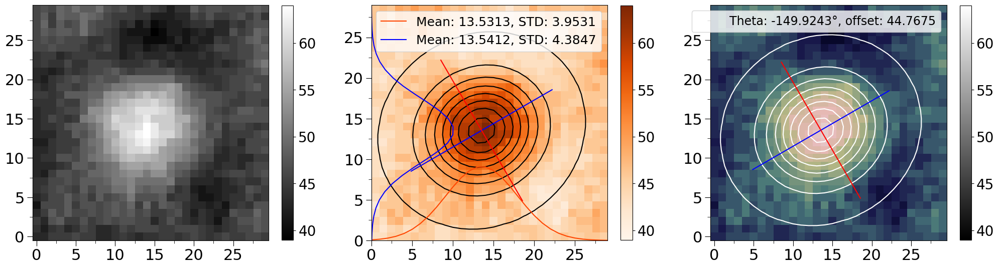

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_53.png


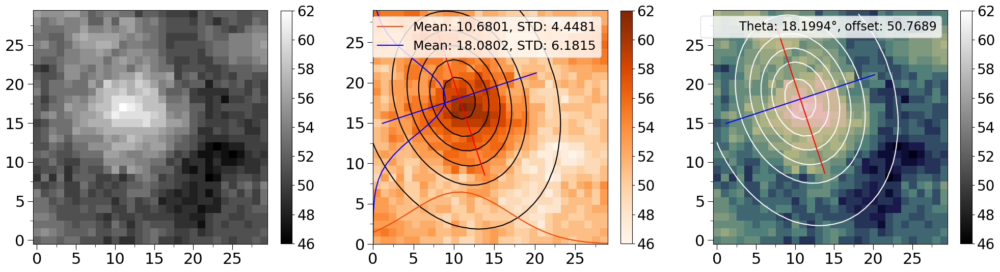

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_54.png


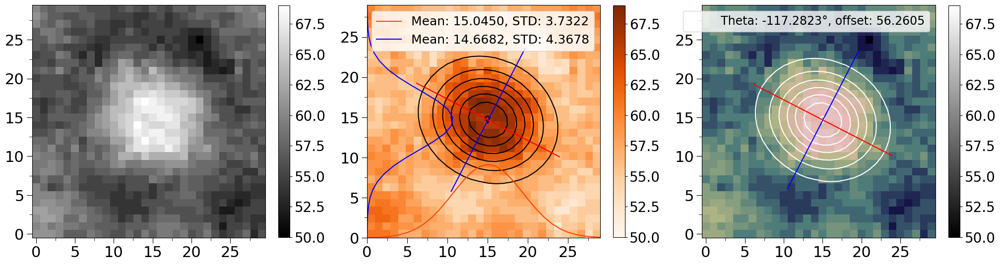

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_55.png


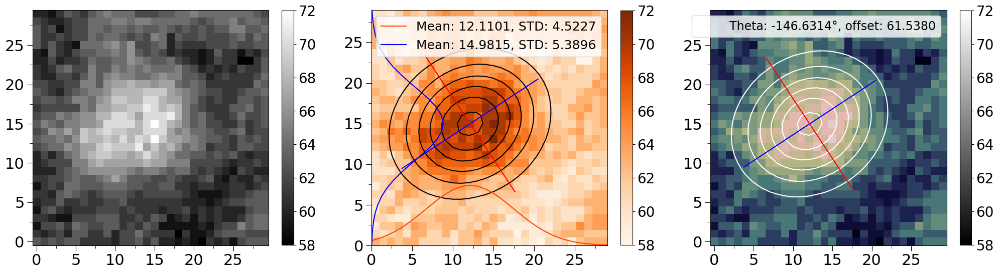

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_56.png


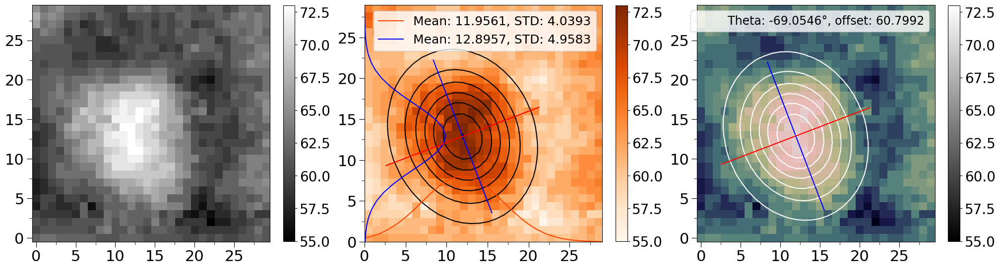

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_57.png


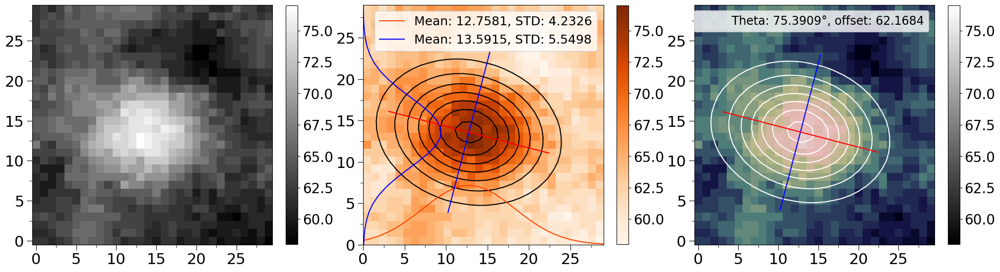

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_59.png


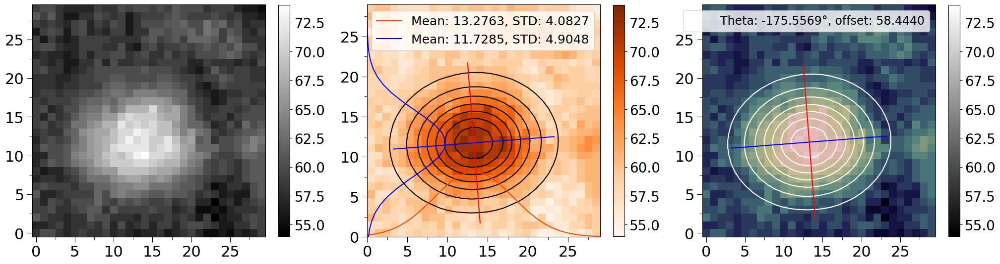

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_60.png


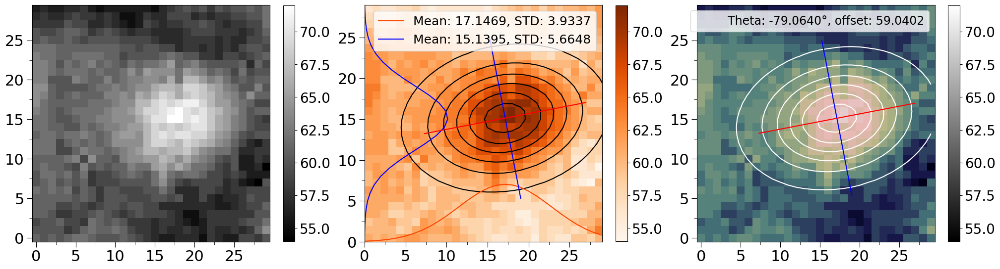

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_61.png


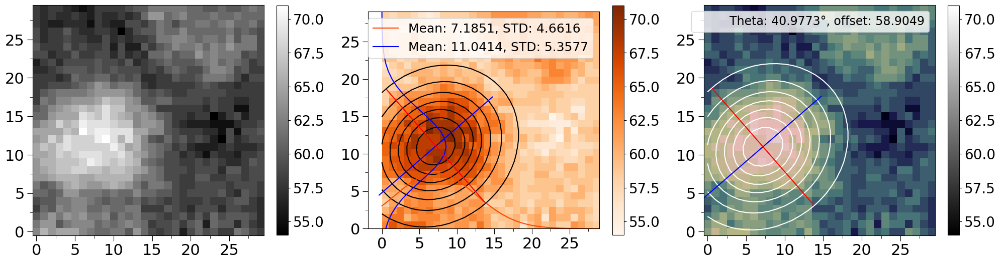

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_62.png


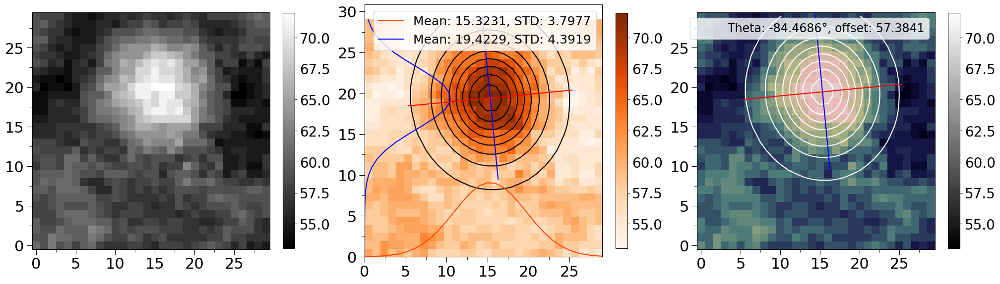

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_63.png


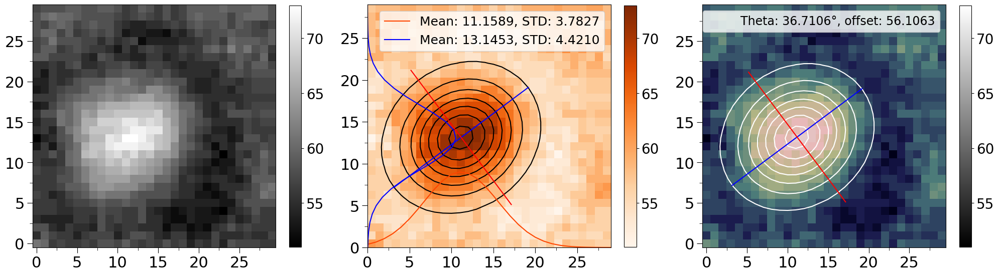

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_64.png


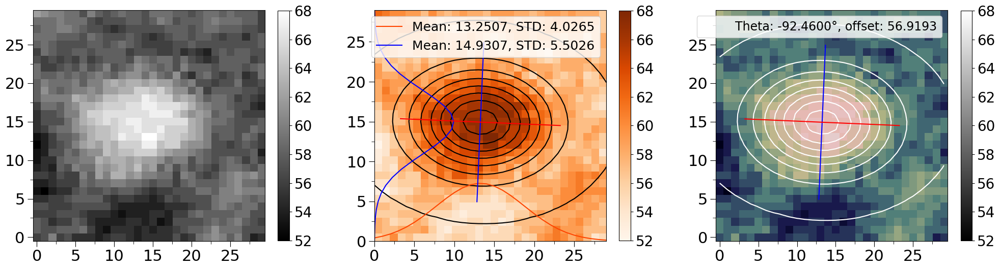

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_65.png


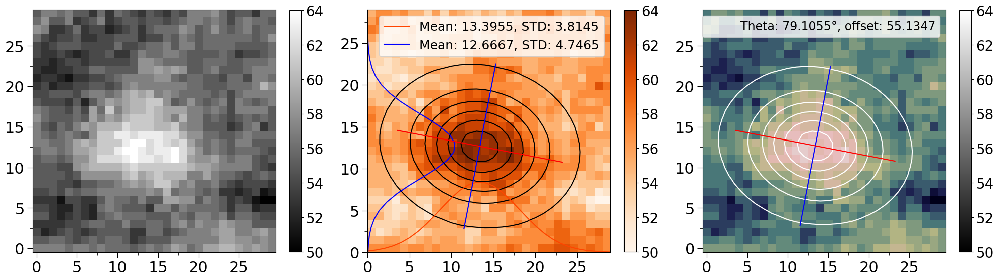

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_66.png


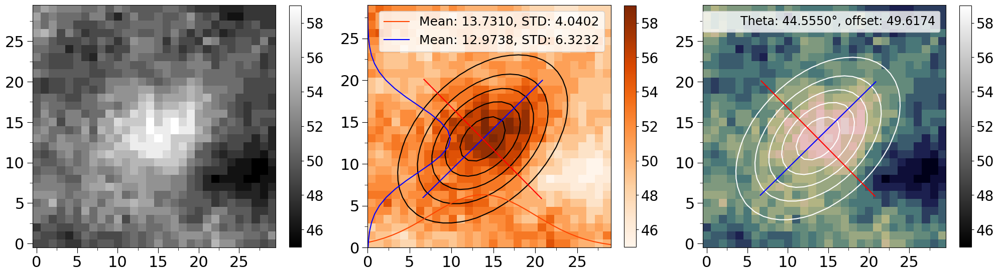

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_67.png


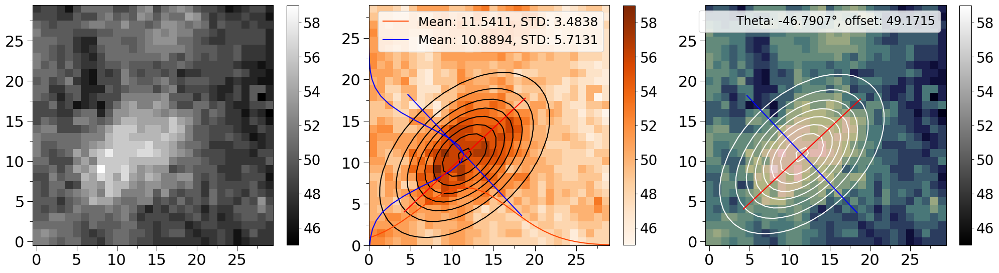

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_69.png


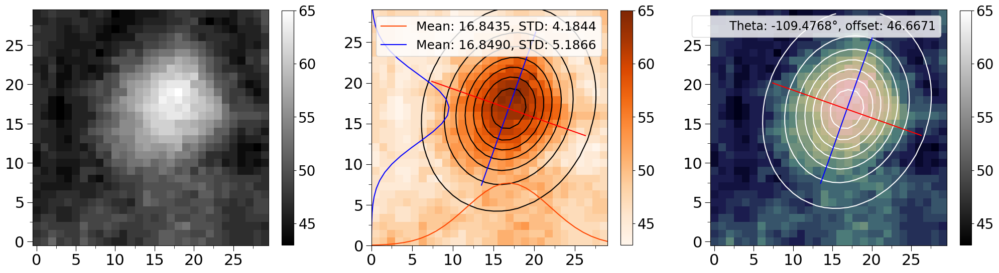

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_70.png


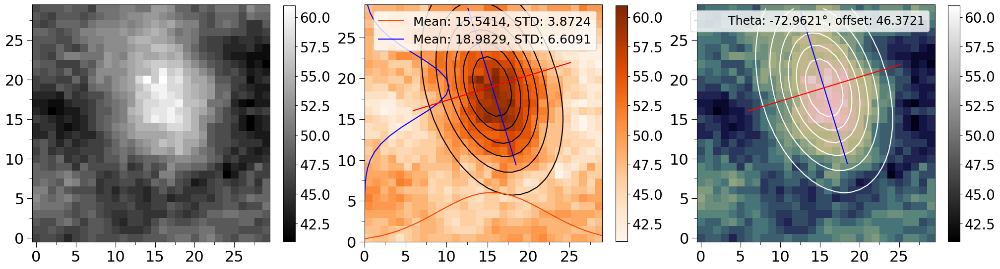

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_71.png


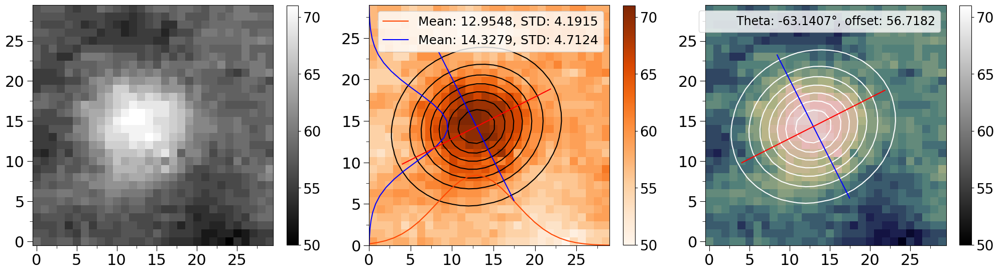

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_72.png


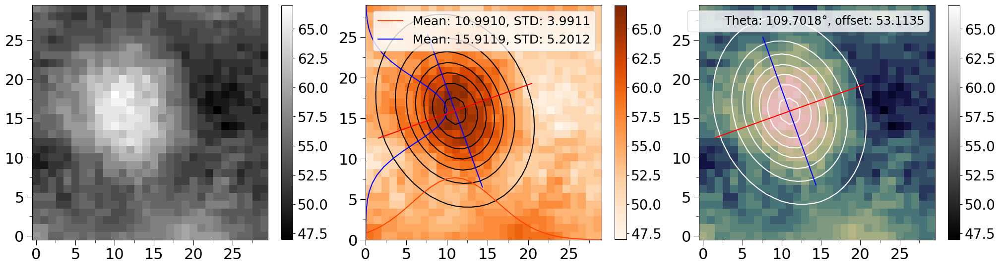

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_73.png


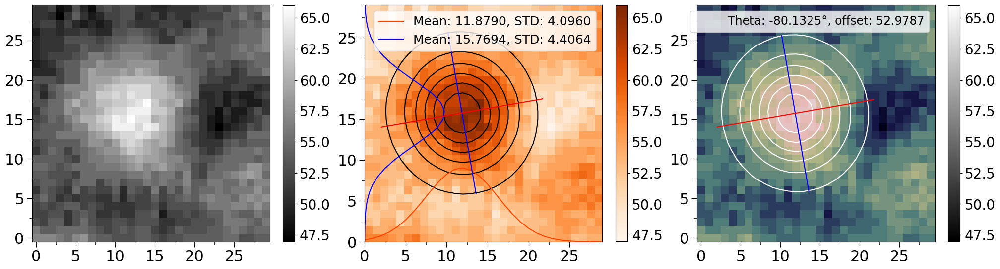

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_74.png


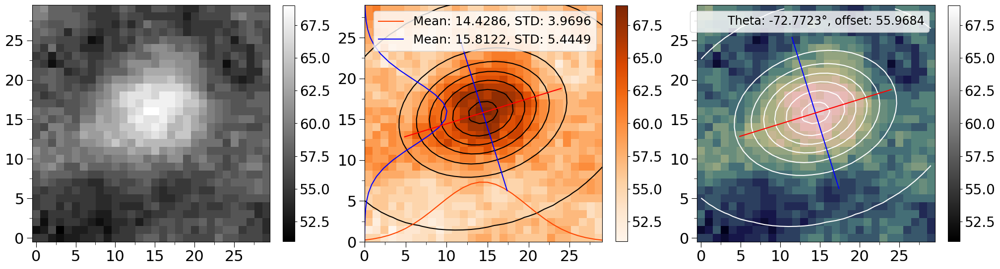

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_75.png


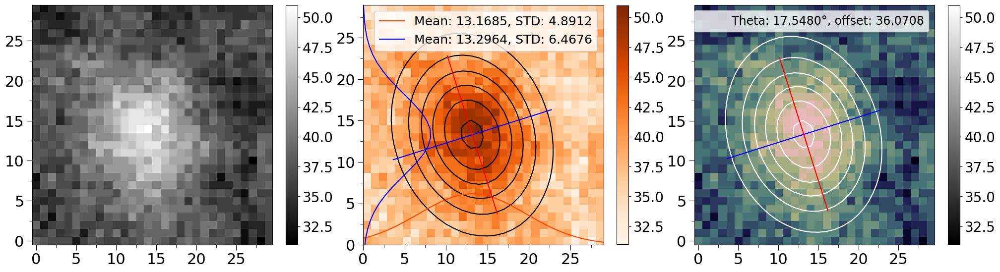

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_76.png


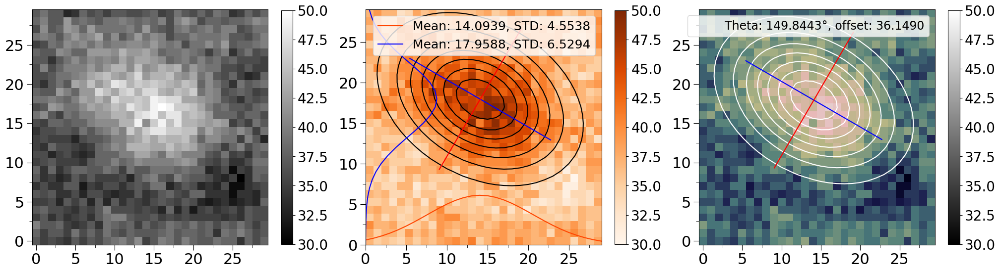

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_77.png


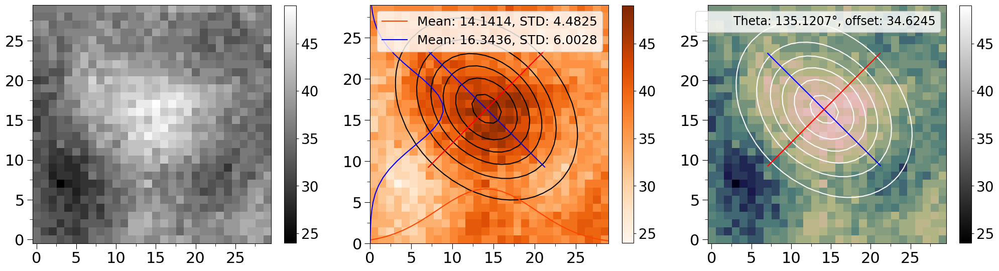

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_78.png


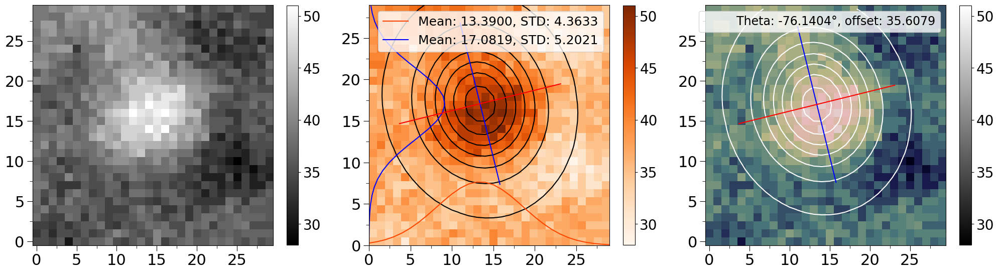

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_79.png


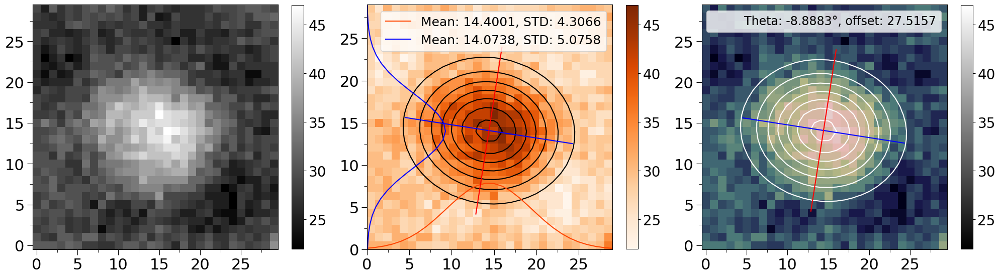

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_80.png


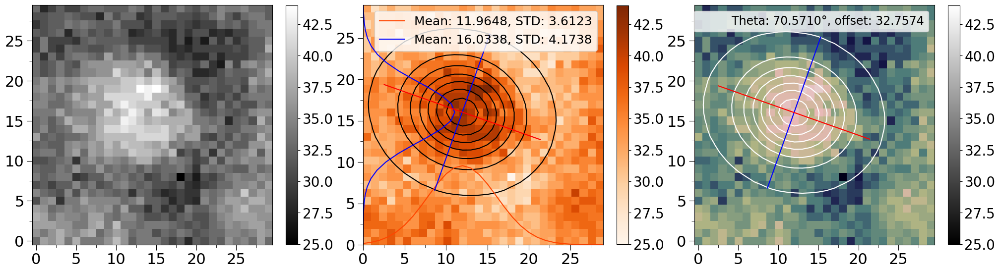

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_81.png


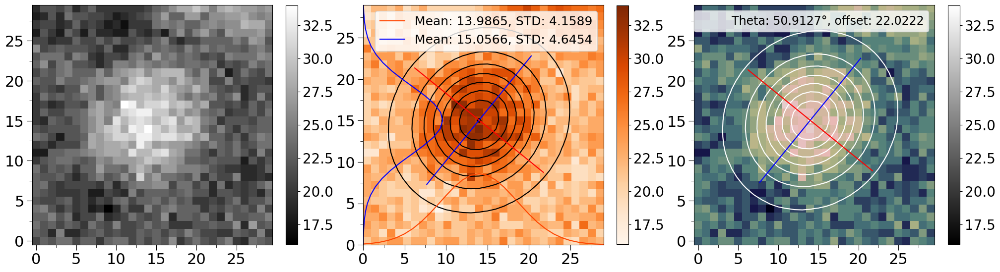

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_83.png


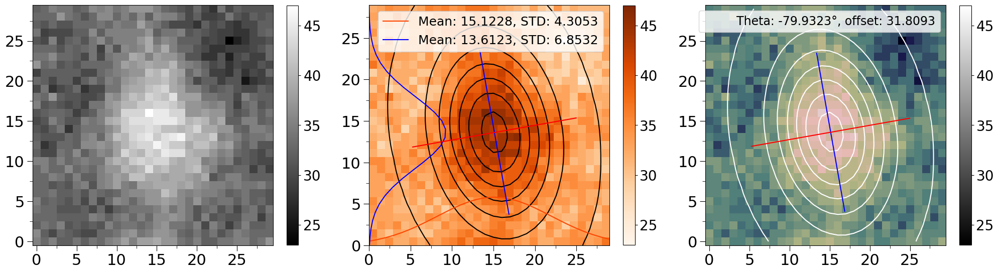

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_84.png


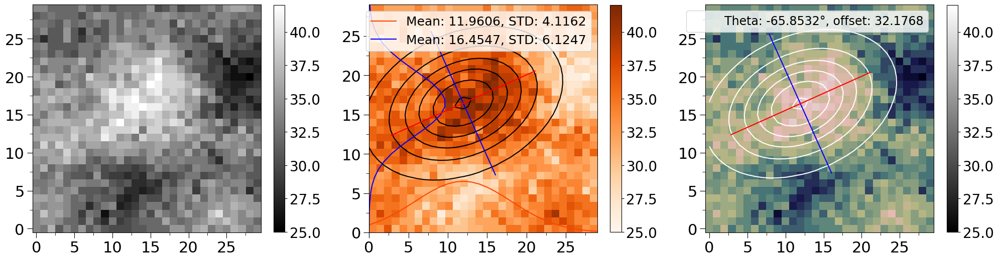

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_85.png


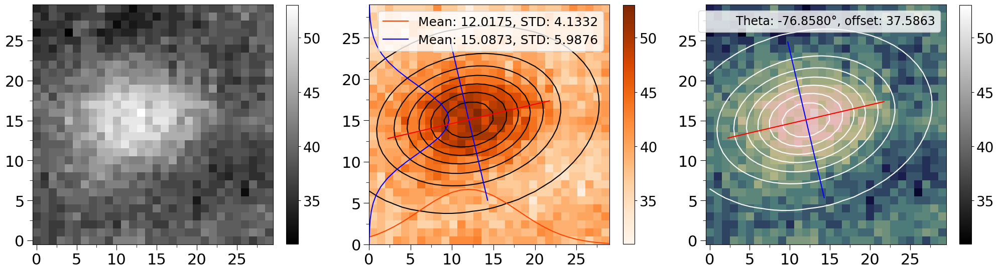

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_86.png


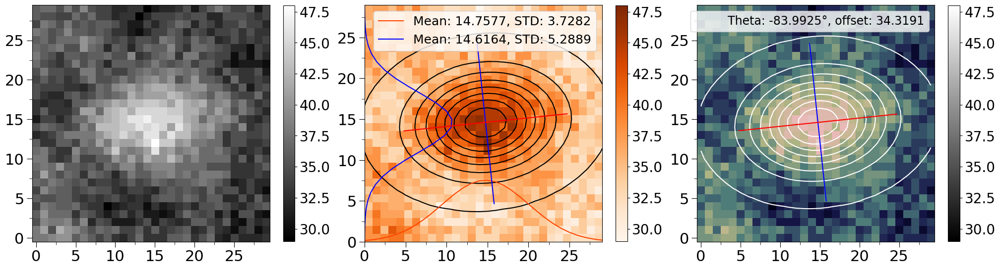

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_87.png


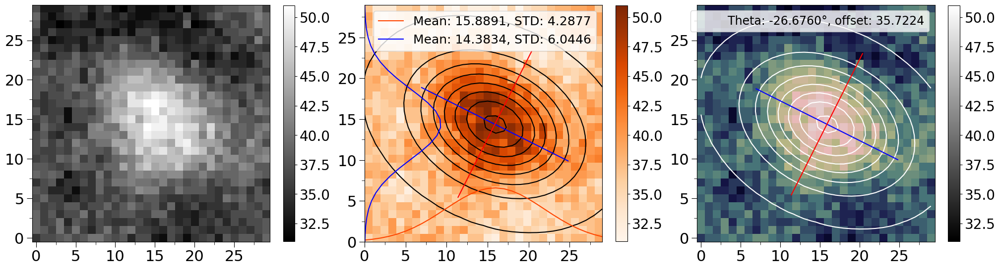

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_88.png


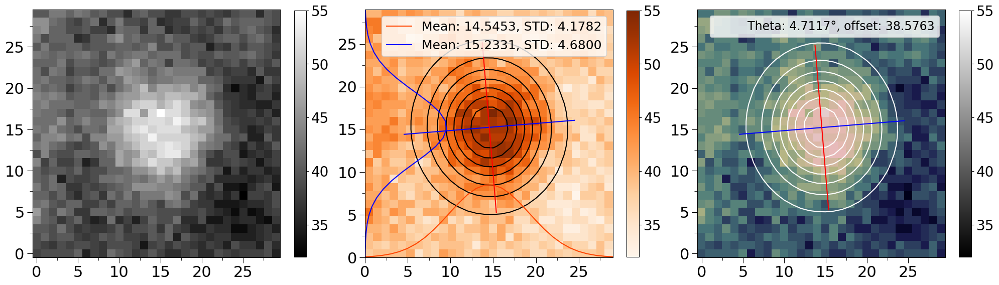

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_89.png


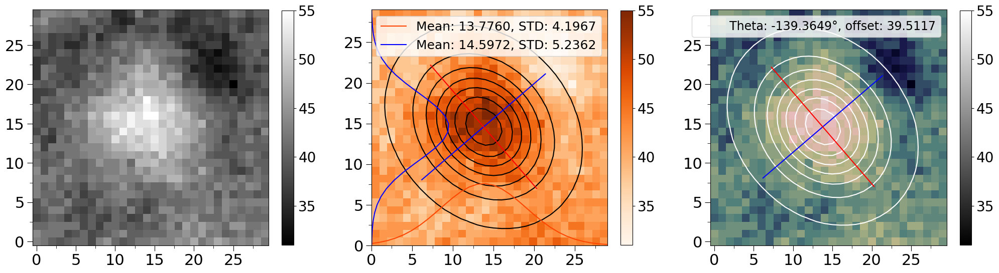

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_90.png


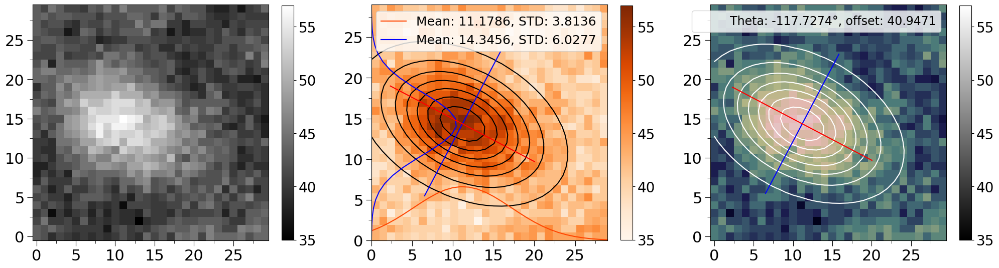

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_91.png


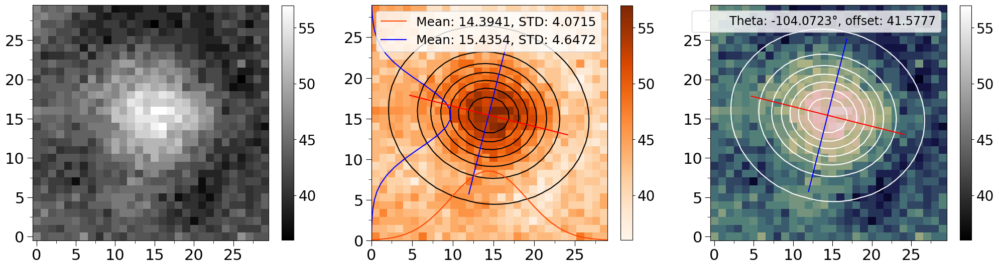

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_93.png


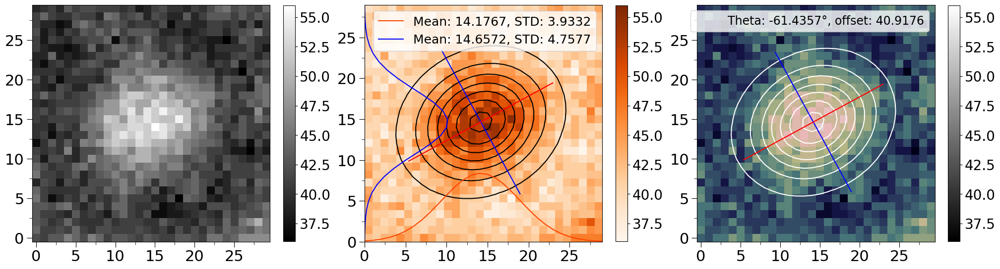

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_94.png


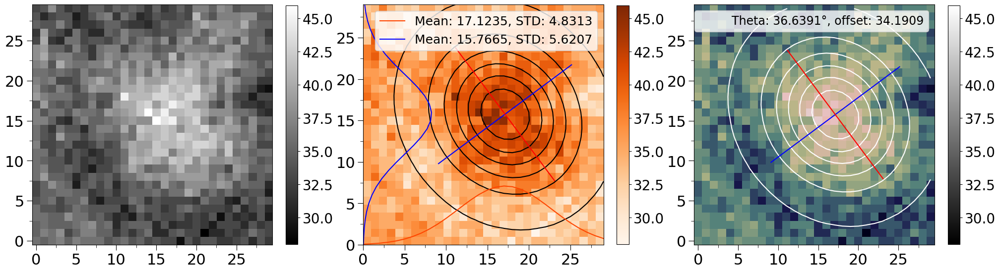

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_96.png


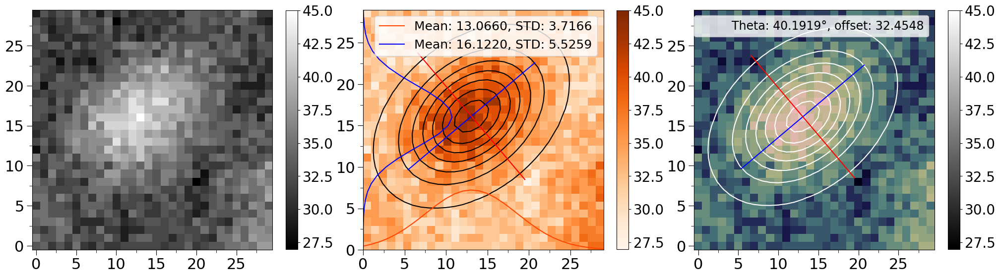

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_97.png


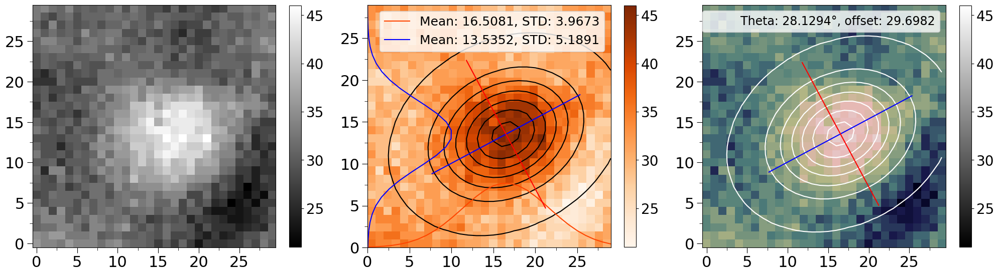

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_98.png


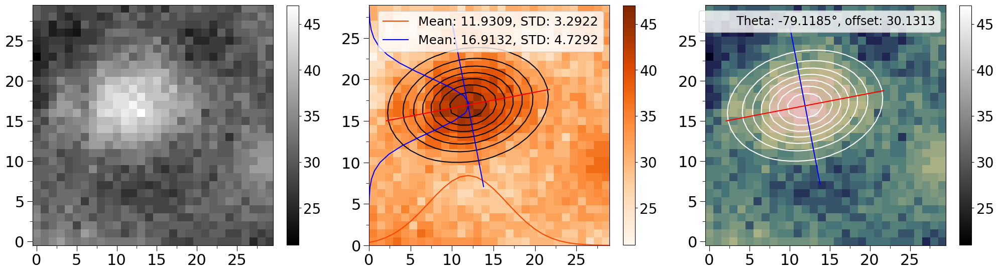

c:\Users\Leyang\Documents\GitHub\LOCA-PRAM\images/aunp/psf_99.png


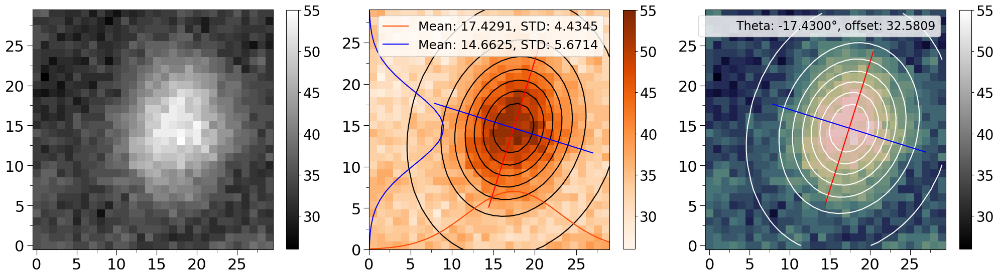

Mean of Standard Deviation X-Axis: 5.04419999185426, STD of STD X-Axis: 0.8448107556059596
Mean of Standard Deviation Y-Axis: 3.846040860188225, STD of STD X-Axis: 0.4094968400201318
Mean of offsets: 50.307001868225235, STD of offsets: 10.181019025004378
Mean of Amplitude: 12.4540673624417, STD of amplitudes: 2.8746216403877187
amplitudes : [12.33174768 12.04280999 10.1344871  14.67889405  9.28819797 13.18063917
 11.89644033 12.33218558 10.5464874  14.93378028 13.09077552 13.12790511
 14.13983621 13.15434788 11.16688319  7.81596197 12.56516773  9.66473247
  7.65116336 16.79452248 11.27405923  9.09614974  8.81761621 13.19714188
 14.4567763  11.33371339 20.81467741  9.47217316 12.64573469  9.6073572
 12.36304288  9.31661531 10.83684192  6.42445312  8.56716011 13.46159666
 12.82161071 13.58789665 13.92480528 10.43693336  9.49316504 12.77434453
  9.46563387 10.79637385  9.60619302 14.73876254  9.79390811 13.23878817
 11.98428159 19.14634084  8.51455286 13.90589179  9.43543344 13.26503443
 

In [2]:
def twoD_Gaussian(xy, amplitude, xo, yo, sigma_x, sigma_y, theta, offset):
    x, y = xy
    xo = float(xo)
    yo = float(yo)    
    a = (np.cos(theta)**2/(2*sigma_x**2)) + (np.sin(theta)**2/(2*sigma_y**2))
    b = -(np.sin(2*theta)/(4*sigma_x**2)) + (np.sin(2*theta)/(4*sigma_y**2))
    c = (np.sin(theta)**2/(2*sigma_x**2)) + (np.cos(theta)**2/(2*sigma_y**2))
    g = offset + amplitude * np.exp(-(a*((x-xo)**2) + 2*b*(x-xo)*(y-yo) + c*((y-yo)**2)))
    return g.ravel()

def find_images(pattern, path):
    result = []
    for root, dirs, files in os.walk(path):
        for name in files:
            if fnmatch.fnmatch(name, pattern):
                result.append(os.path.join(root, name))
    return result

psf_images_dir = find_images('psf_[0-9]*.png', os.path.join(os.getcwd(), 'images/aunp/'))

mus = []
stds = []
stds_ratio = []
thetas = []
offsets = []
amplitudes = []
rmse_list = [] 

for i, psf_dir in enumerate(psf_images_dir): 
    print(psf_dir)
    psf_image = -np.asarray(Image.open(psf_dir).convert('L'))
    img_width, img_height = psf_image.shape

    # Create x and y indices
    x_axis = np.linspace(0, img_width - 1, img_width)
    y_axis = np.linspace(0, img_height - 1 , img_height)
    x, y = np.meshgrid(x_axis, y_axis, indexing='xy')
    
    data_noisy = psf_image.ravel()

    initial_guess = (5, 15, 15, 2, 2, np.pi/2, 1)
    popt, pcov = opt.curve_fit(twoD_Gaussian, (x, y), data_noisy, p0=initial_guess)

    data_fitted = twoD_Gaussian((x, y), *popt)
    
    mu = [popt[1], popt[2]]
    std = [abs(popt[3]), abs(popt[4])]

    # Calculate RMSE for the fitted Gaussian
    rmse = np.sqrt(np.mean((data_noisy - data_fitted) ** 2))
    rmse_list.append(rmse)

    if std[0] < std[1]:
        temp = std[0]
        std[0] = std[1]
        std[1] = temp

    theta_radians = (-1) * popt[5]  # Correct the rotation for the image coordinate system
    theta_degrees = np.degrees(theta_radians) # Convert radians to degrees
    theta_degrees = ((theta_degrees + 180) % 360) - 180 # Normalize the angle to be within the range of -180 to 180 degrees
    theta_radians = np.radians(theta_degrees)

    mus.append(mu)
    stds.append(std)
    stds_ratio.append(std[0]/std[1])
    thetas.append(theta_degrees)
    offsets.append(popt[6])
    amplitudes.append(popt[0])

    x_prime_endpoint_pos = (mu[0] + 10 * np.cos(theta_radians), mu[1] + 10 * np.sin(theta_radians))
    x_prime_endpoint_neg = (mu[0] - 10 * np.cos(theta_radians), mu[1] - 10 * np.sin(theta_radians))
    y_prime_endpoint_pos = (mu[0] - 10 * np.sin(theta_radians), mu[1] + 10 * np.cos(theta_radians))
    y_prime_endpoint_neg = (mu[0] + 10 * np.sin(theta_radians), mu[1] - 10 * np.cos(theta_radians))

    fig, axs = plt.subplots(1,3, figsize=(20, 7))
    for i, ax in enumerate(axs.flatten()):
        ax.tick_params(axis='both', which='major', labelsize=22, length=8)  # Major ticks
        ax.tick_params(axis='both', which='minor', labelsize=20, length=4)  # Minor ticks
        ax.set_xticks([0, 5, 10, 15, 20, 25, 30])  # Adjust this to your specific density values
        ax.set_yticks([0, 5, 10, 15, 20, 25, 30])
        ax.xaxis.set_minor_locator(AutoMinorLocator(2))  # 2 minor ticks between each major tick
        ax.yaxis.set_minor_locator(AutoMinorLocator(2))  # 2 minor ticks between each major tick
        asp = np.diff(ax.get_xlim())[0] / np.diff(ax.get_ylim())[0]
        ax.set_aspect(asp) # To set the aspect ratio the same for all images

        if i == 0:
            a = ax.imshow(psf_image, cmap='gray', origin='lower')
        if i == 1:
            a = ax.imshow(psf_image, cmap='Oranges', origin='lower', extent=(x.min(), x.max(), y.min(), y.max()))
            ax.contour(x, y, data_fitted.reshape(img_height, img_width), 7, colors='black')
            ax.plot(x_axis, 100 * norm.pdf(x_axis, mu[0], std[0]), c='orangered', label=f"Mean: {mu[0]:.4f}, STD: {std[1]:.4f}")
            ax.plot(100 * norm.pdf(x_axis, mu[1], std[1]), y_axis, c='blue', label=f"Mean: {mu[1]:.4f}, STD: {std[0]:.4f}")
            ax.plot([x_prime_endpoint_neg[0], x_prime_endpoint_pos[0]], [x_prime_endpoint_neg[1], x_prime_endpoint_pos[1]], 'b-')
            ax.plot([y_prime_endpoint_neg[0], y_prime_endpoint_pos[0]], [y_prime_endpoint_neg[1], y_prime_endpoint_pos[1]], 'r-')
            ax.legend(loc="upper right", fontsize=18)
        if i == 2:
            a = ax.imshow(psf_image, cmap='gray', origin='lower')
            ax.imshow(psf_image, alpha=0.2, cmap="jet", origin='lower')
            ax.contour(x, y, data_fitted.reshape(img_height, img_width), 7, colors='white')
            ax.plot([x_prime_endpoint_neg[0], x_prime_endpoint_pos[0]], [x_prime_endpoint_neg[1], x_prime_endpoint_pos[1]], 'b-')
            ax.plot([y_prime_endpoint_neg[0], y_prime_endpoint_pos[0]], [y_prime_endpoint_neg[1], y_prime_endpoint_pos[1]], 'r-')
            ax.plot([], [], ' ', label=f"Theta: {theta_degrees:.4f}°, offset: {popt[6]:.4f}")
            # ax.set_title(f'Gaussian Fitting\n(Angle of Rotation and Offset)', fontsize=20)
            ax.legend(loc="upper right", fontsize=17)
        
        # Add a colorbar with custom font size
        cbar = fig.colorbar(a, ax=ax, fraction=0.045)
        cbar.ax.tick_params(labelsize=20)  # Set font size for colorbar ticks
        # cbar.set_label('Colorbar Label', fontsize=20)  # Set font size for the colorbar label

    plt.tight_layout()
    plt.show()


stds = np.asarray(stds).transpose((1,0))
thetas = np.asarray(thetas)
offsets = np.asarray(offsets)
amplitudes = np.asarray(amplitudes)


print(f"Mean of Standard Deviation X-Axis: {np.mean(stds[0,:])}, STD of STD X-Axis: {np.std(stds[0,:])}")
print(f"Mean of Standard Deviation Y-Axis: {np.mean(stds[1,:])}, STD of STD X-Axis: {np.std(stds[1,:])}" )
print(f"Mean of offsets: {np.mean(offsets)}, STD of offsets: {np.std(offsets)}" )
print(f"Mean of Amplitude: {np.mean(amplitudes)}, STD of amplitudes: {np.std(amplitudes)}")
print(f"amplitudes : {amplitudes}")
print(f"Mean RMSE: {np.mean(rmse_list)}, STD of RMSE: {np.std(rmse_list)}")


## 3D graph of sigma_x, sigma_y, and amplitude 
### ellipsoid drawing with its center at each axis mean

(92, 3)
[[[ 0.72154813  0.23202574 -0.31864128]
  [ 0.23202574  0.16953038  0.1931802 ]
  [-0.31864128  0.1931802   8.35425671]]]


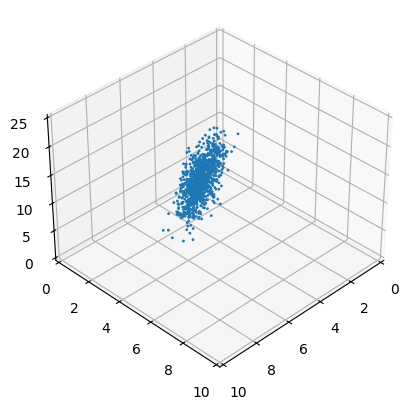

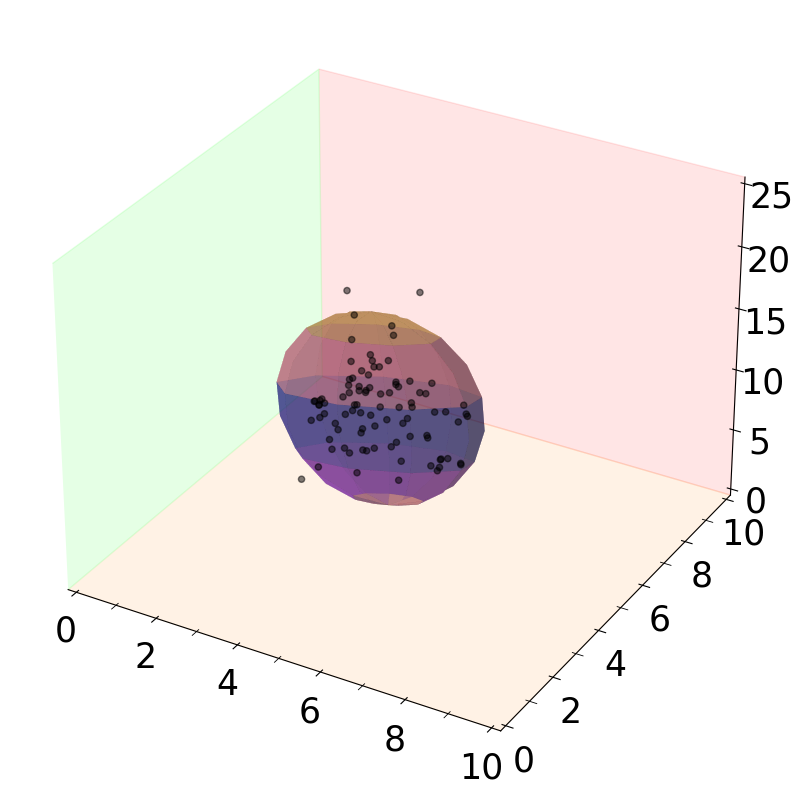

In [3]:
plt.close('all')
from matplotlib import cm
import matplotlib.cm as cmx
import pandas as pd
import openpyxl

raw_data_points = np.array([stds[0], stds[1], amplitudes]).T
print(raw_data_points.shape)

means = np.array([[stds[0].mean(), stds[1].mean(), amplitudes.mean()]])
# Constructing the data points for covariance calculation
data_points = np.vstack((stds[0], stds[1], amplitudes)).T  # Shape should be (n_samples, n_features)

# Calculate the covariance matrix
cov_matrix = np.cov(data_points, rowvar=False)  # Set rowvar=False to treat columns as variables
covs = np.array([cov_matrix])
print(covs)

n_gaussians = means.shape[0]  #Number of clusters

N = 1000 # Number of points to be generated for each cluster.
points = []
for i in range(len(means)):
    x = np.random.multivariate_normal(means[i], covs[i], N )
    points.append(x)
points = np.concatenate(points)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(points[:,0], points[:,1], points[:,2], s=1, alpha=1)
ax.view_init(35.246, 45)
ax.set_xlim([0, 10])
ax.set_ylim([0, 10])
ax.set_zlim([0, 25])
plt.show()

#fit the gaussian model
gmm = GaussianMixture(n_components=n_gaussians, covariance_type='diag')
gmm.fit(points)

def plot_sphere(w=0, c=[0,0,0], r=[1, 1, 1], subdev=20, ax=None, sigma_multiplier=3):
    '''
        plot a sphere surface
        Input: 
            c: 3 elements list, sphere center
            r: 3 element list, sphere original scale in each axis ( allowing to draw elipsoids)
            subdiv: scalar, number of subdivisions (subdivision^2 points sampled on the surface)
            ax: optional pyplot axis object to plot the sphere in.
            sigma_multiplier: sphere additional scale (choosing an std value when plotting gaussians)
        Output:
            ax: pyplot axis object
    '''

    if ax is None:
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
    pi = np.pi
    cos = np.cos
    sin = np.sin
    phi, theta = np.mgrid[0.0:pi:complex(0,subdev), 0.0:2.0 * pi:complex(0,subdev)]
    x = sigma_multiplier*r[0] * sin(phi) * cos(theta) + c[0]
    y = sigma_multiplier*r[1] * sin(phi) * sin(theta) + c[1]
    z = sigma_multiplier*r[2] * cos(phi) + c[2]
    cmap = cmx.ScalarMappable()
    cmap.set_cmap('jet')
    c = cmap.to_rgba(w)

    ax.plot_surface(x, y, z, color=c, alpha=0.2, linewidth=1)

    return ax

def plot_ellipsoid(c, cov, ax=None, color='blue', alpha=0.9, radius_multiplier=2.5, subdev=10):
    ax = ax or plt.gca()
    
    # Calculate the eigenvalues and eigenvectors
    eigenvalues, eigenvectors = np.linalg.eigh(cov)

    # Create a grid of points on a unit sphere
    phi = np.linspace(0, np.pi, subdev)  # Increase density for smoother surface
    theta = np.linspace(0, 2 * np.pi, subdev)
    # Create meshgrid for spherical coordinates
    phi, theta = np.meshgrid(phi, theta)
    # Parametrize the surface of the ellipsoid
    x = radius_multiplier * np.sqrt(eigenvalues[0]) * np.outer(np.sin(phi), np.cos(theta))
    y = radius_multiplier * np.sqrt(eigenvalues[1]) * np.outer(np.sin(phi), np.sin(theta))
    z = radius_multiplier * np.sqrt(eigenvalues[2]) * np.outer(np.cos(phi), np.ones_like(theta))
    # Rotate the ellipsoid using the eigenvectors

    ellipsoid_points = np.dot(eigenvectors, np.array([x.flatten(), y.flatten(), z.flatten()]))
    x = ellipsoid_points[0].reshape(x.shape) + c[0]
    y = ellipsoid_points[1].reshape(y.shape) + c[1]
    z = ellipsoid_points[2].reshape(z.shape) + c[2]
    
    # Calculate the radial distance from the center
    distances = np.sqrt((x - c[0])**2 + (y - c[1])**2 + (z - c[2])**2)
    
    # Normalize distances to range [0, 1]
    normalized_distances = (distances - distances.min()) / (distances.max() - distances.min()) - 0.2

    # Create a color map based on normalized distances
    my_col = cm.plasma(normalized_distances)  # You can choose a different colormap

    # Plot the surface of the ellipsoid
    ax.plot_surface(x, y, z, facecolors=my_col, alpha=alpha, linewidth=0, antialiased=True, shade=True)

def visualize_3d_gmm(points, w, mu, stdev):
    '''
    plots points and their corresponding gmm model in 3D
    Input: 
        points: N X 3, sampled points
        w: n_gaussians, gmm weights
        mu: 3 X n_gaussians, gmm means
        stdev: 3 X n_gaussians, gmm standard deviation (assuming diagonal covariance matrix)
    Output:
        None
    '''

    n_gaussians = mu.shape[1]
    N = int(np.round(points.shape[0] / n_gaussians))
    N = raw_data_points.shape[0]
    # Visualize data
    
    # Create a 2x2 subplot structure
    fig = plt.figure(figsize=(10, 10))
    # Top-left: 3D projection
    ax_3d = fig.add_subplot(111, projection='3d')
    ax_3d.set_facecolor('none')
    
    colors = cmx.Set1(np.linspace(0, 1, n_gaussians))
    # Set the background color to transparent
    for i in range(n_gaussians):
        idx = range(i * N, (i + 1) * N)
        # axes.scatter(points[idx, 0], points[idx, 1], points[idx, 2], alpha=0.3, c=colors[i])
        ax_3d.scatter(raw_data_points[idx, 0], raw_data_points[idx, 1], raw_data_points[idx, 2], s=20, alpha=0.5, c='black')
        # plot_sphere(w=w[i], c=mu[:, i], r=stdev[:, i], ax=axes)
        plot_ellipsoid(means[i], covs[i], ax=ax_3d, alpha=0.05)

    ax_3d.set_title('')
    ax_3d.set_xlabel('')
    ax_3d.set_ylabel('')
    ax_3d.set_zlabel('')
    ax_3d.set_xlim([0, 10])
    ax_3d.set_ylim([0, 10])
    ax_3d.set_zlim([0, 25])
    ax_3d.grid(False)
    ax_3d.xaxis.set_pane_color((0.0, 1.0, 0.0, 0.1))  # Orange for XY plane
    ax_3d.yaxis.set_pane_color((1.0, 0.0, 0.0, 0.1))  # Red for XZ plane
    ax_3d.zaxis.set_pane_color((1.0, 0.5, 0.0, 0.1))  # Green for YZ plane
    ax_3d.xaxis.set_minor_locator(AutoMinorLocator(2))  # 2 minor ticks between each major tick
    ax_3d.yaxis.set_minor_locator(AutoMinorLocator(2))  # 2 minor ticks between each major tick
    ax_3d.tick_params(axis='both', which='major', labelsize=25, length=12)  # Major ticks
    ax_3d.tick_params(axis='both', which='minor', labelsize=23, length=6)  # Minor ticks

    ax_3d.xaxis._axinfo["grid"]['linewidth'] = 0.0
    ax_3d.yaxis._axinfo["grid"]['linewidth'] = 0.0
    ax_3d.zaxis._axinfo["grid"]['linewidth'] = 0.0

    # plt.savefig('demo.png', transparent=True, dpi=600)
    # plt.tight_layout()
    plt.show()
    
    # Convert raw_data_points to a pandas DataFrame
    df = pd.DataFrame(raw_data_points, columns=['X', 'Y', 'Z'])
    # Output the DataFrame to an Excel file
    output_filename = 'raw_data_points.xlsx'
    df.to_excel(output_filename, index=False)

visualize_3d_gmm(points, gmm.weights_, gmm.means_.T, np.sqrt(gmm.covariances_).T)